<a href="https://colab.research.google.com/github/MadBunny999/ITMO-Road-vlm-assistant/blob/main/notebooks/Multiclass_yolo_traffic_detection_baseline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import json
!mkdir ~/.kaggle
!touch ~/.kaggle/kaggle.json
api_token = {"username":"", "key":""}

with open('/root/.kaggle/kaggle.json', 'w+') as file:
    json.dump(api_token, file)
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d watchman/rtsd-dataset
from zipfile import ZipFile
with ZipFile('rtsd-dataset.zip', 'r') as zip_ref:
    zip_ref.extractall()

In [ ]:
!pip install ultralytics
!pip install -e .
!pip install click
!pip install Sphinx
!pip install coverage
!pip install awscli
!pip install flake8
!pip install python-dotenv>=0.5.1
!pip install opencv-python~=4.8.1.78
!pip install pybboxes~=0.1.6
!pip install mlflow

In [ ]:
import os
import cv2
import random
import numpy as np
import pandas as pd
from tqdm import tqdm
import shutil
from shutil import copyfile
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')
from PIL import Image
import ultralytics
from ultralytics import YOLO
ultralytics.checks()
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import sys
import pybboxes as pbx
from google.colab.patches import cv2_imshow

import warnings
warnings.filterwarnings('ignore')

In [ ]:
import mlflow
from ultralytics import settings

# Update a setting
settings.update({'mlflow': True})

# Reset settings to default values
settings.reset()

In [ ]:
mlflow.set_tracking_uri("http://5.9.178.136:5000/")

In [ ]:
data = pd.read_csv('/content/full-gt.csv')
data.head()

In [ ]:
!mkdir data
!rm /content/rtsd-dataset.zip

In [ ]:
COCO_LABELS_PATH = '/content/full-gt.csv'
IMAGES_DIR = '/content/rtsd-frames/rtsd-frames'
YOLO_LABELS_DIR = '/content/data'


def make_yolo_annotations(coco_labels_path, images_dir, yolo_labels_dir):
    """
    Creating yolo annotation .txt files from coco csv file (labels_path).
    Each row in coco csv file has the structure image_filename,x_lt, y_lt, width, height,
    classname, object_id

    :param coco_labels_path: Path to a labels.csv file of coco annotations
    :param images_dir: Path to an images directory. Needed to get image shape and transform coco
    to yolo
    :param yolo_labels_dir: Path to directory, where yolo .txt files will be stored.
    So create labels directory first
    :return: None
    """

    coco_anns = make_coco_dict(coco_labels_path, images_dir)
    count = 0

    for image_name, annotations in coco_anns.items():
        yolo_annotations = []
        count += 1

        if count % 10000 == 0:
            print("10000...")

        for coco_annotation in annotations:
            yolo_class, *coco_bbox = coco_annotation

            img_path = os.path.join(images_dir, image_name)
            img_width, img_height = cv2.imread(img_path).shape[:2][::-1]
            yolo_bbox = coco_to_yolo(*coco_bbox, img_width, img_height)

            yolo_bbox = [str(el) for el in yolo_bbox]
            yolo_annotation = str(yolo_class) + " " + " ".join(yolo_bbox)
            yolo_annotations.append(yolo_annotation)

        yolo_annotations_text = "\n".join(yolo_annotations)
        label_name = image_name.replace("jpg", "txt")
        label_path = os.path.join(yolo_labels_dir, label_name)
        img_path = os.path.join(images_dir, image_name)

        if yolo_annotations_text:
            with open(label_path, "w") as label_file:
                # print(yolo_annotations_text)
                # print(label_path)
                # print(img_path)
                label_file.write(yolo_annotations_text)


def make_coco_dict(coco_labels_path, images_dir):
    """
    Creating dictionary with coco annotations.

    :param coco_labels_path: Path to a labels.csv file of coco annotations
    :param images_dir: Path to an images directory. Needed to get image shape and transform coco
    to yolo
    :return: Dictionary with structure {image_filename: [[object_class, x_start, y_start, width, height]]}
    """

    images_anns = {image: [] for image in os.listdir(images_dir)}
    yolo_classes = {}
    yolo_classes_counter = 0

    with open(coco_labels_path) as f:
        _ = f.readline()

        for annotation in f:
            filename, x_from, y_from, width, height, sign_class, _ = annotation.split(",")

            if sign_class not in yolo_classes:
                yolo_classes[sign_class] = yolo_classes_counter
                yolo_classes_counter += 1

            images_anns[filename].append([
                yolo_classes[sign_class], int(x_from), int(y_from), int(width), int(height)
            ])
    return images_anns


def coco_to_yolo(x_start, y_start, width, height, img_width, img_height):
    """
    Making yolo bounding box from coco bounding box

    :param x_start: Top-left x
    :param y_start: Top-left y
    :param width: Bounding box width
    :param height: Bounding box height
    :param img_width: Image width
    :param img_height: Image height
    :return: Yolo bounding bbox. [x-c, y-c, w, h] Center coordinates & width & height
    """
    return pbx.convert_bbox((x_start, y_start, width, height),
                            from_type="coco", to_type="yolo", image_size=(img_width, img_height))


make_yolo_annotations(COCO_LABELS_PATH, IMAGES_DIR, YOLO_LABELS_DIR)

In [ ]:
%ls

In [ ]:
!mkdir datasets
!mkdir datasets/train
!mkdir datasets/valid
!mkdir datasets/test

In [ ]:
# srs_content=[]
# annotations = []
# images = []
# crsPath = '/content/ts/ts'
# train_ratio = 0.7
# valid_ratio = 0.2
# test_ratio = 0.1
# totalImgCount = len(os.listdir(crsPath))/2
# print(totalImgCount)

# for (dirname, dirs, files) in os.walk(crsPath):
#     for filename in files:
#         if filename.endswith('.txt'):
#             annotations.append(filename)
#         else:
#             images.append(filename)

# train_size = int(train_ratio * totalImgCount)
# valid_size = int(valid_ratio * totalImgCount)
# test_size = int(test_ratio * totalImgCount)

# print(train_size)
# print(valid_size)
# print(test_size)

In [ ]:
srs_content=[]
annotations = []
images = []
imgPath = '/content/rtsd-frames/rtsd-frames'
annoPath = '/content/data'
train_ratio = 0.7
valid_ratio = 0.2
test_ratio = 0.1
totalImg = os.listdir(imgPath)
totalAnno = os.listdir(annoPath)
totalImgCount = len(totalImg)
totalAnnoCount = len(totalAnno)
print(totalImgCount,totalAnnoCount)

train_size = int(train_ratio * totalAnnoCount)
valid_size = int(valid_ratio * totalAnnoCount)
test_size = int(test_ratio * totalAnnoCount)

print(train_size)
print(valid_size)
print(test_size)

In [ ]:
!mkdir datasets/train/labels
!mkdir datasets/train/images
!mkdir datasets/valid/labels
!mkdir datasets/valid/images
!mkdir datasets/test/labels
!mkdir datasets/test/images

In [ ]:
from random import choice
trainimagePath = '/content/datasets/train/images'
trainlabelPath = '/content/datasets/train/labels'
valimagePath = '/content/datasets/valid/images'
vallabelPath = '/content/datasets/valid/labels'
testimagePath = '/content/datasets/test/images'
testlabelPath = '/content/datasets/test/labels'
#cycle for train dir
for x in range(train_size):

    fileTxt = choice(totalAnno) # get name of random image from origin dir
    fileJpg = fileTxt[:-4] +'.jpg' # get name of corresponding annotation file

    #move both files into train dir
    #shutil.move(os.path.join(crsPath, fileJpg), os.path.join(trainimagePath, fileJpg))
    #shutil.move(os.path.join(crsPath, fileXml), os.path.join(trainlabelPath, fileXml))
    shutil.copy(os.path.join(imgPath, fileJpg), os.path.join(trainimagePath, fileJpg))
    shutil.copy(os.path.join(annoPath, fileTxt), os.path.join(trainlabelPath, fileTxt))


    #remove files from arrays
    totalImg.remove(fileJpg)
    totalAnno.remove(fileTxt)

for x in range(valid_size):

    fileTxt = choice(totalAnno) # get name of random image from origin dir
    fileJpg = fileTxt[:-4] +'.jpg' # get name of corresponding annotation file

    #move both files into train dir
    #shutil.move(os.path.join(crsPath, fileJpg), os.path.join(trainimagePath, fileJpg))
    #shutil.move(os.path.join(crsPath, fileXml), os.path.join(trainlabelPath, fileXml))
    shutil.copy(os.path.join(imgPath, fileJpg), os.path.join(valimagePath, fileJpg))
    shutil.copy(os.path.join(annoPath, fileTxt), os.path.join(vallabelPath, fileTxt))


    #remove files from arrays
    totalImg.remove(fileJpg)
    totalAnno.remove(fileTxt)


#cycle for test dir
for x in range(test_size):

    fileTxt = choice(totalAnno) # get name of random image from origin dir
    fileJpg = fileTxt[:-4] +'.jpg' # get name of corresponding annotation file

    #move both files into train dir
    #shutil.move(os.path.join(crsPath, fileJpg), os.path.join(valimagePath, fileJpg))
    #shutil.move(os.path.join(crsPath, fileXml), os.path.join(vallabelPath, fileXml))
    shutil.copy(os.path.join(imgPath, fileJpg), os.path.join(testimagePath, fileJpg))
    shutil.copy(os.path.join(annoPath, fileTxt), os.path.join(testlabelPath, fileTxt))

    #remove files from arrays
    totalImg.remove(fileJpg)
    totalAnno.remove(fileTxt)

#rest of files will be validation files, so rename origin dir to val dir
#os.rename(crsPath, valPath)



In [ ]:
! rm -r /content/rtsd-frames

In [ ]:
import yaml

data_yaml = dict(
    train ='/content/datasets/train',
    val ='/content/datasets/valid',
    test='/content/datasets/test',
    nc =198,
    names =['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15',
            '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29',
            '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43',
            '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57',
            '58', '59', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '70', '71',
            '72', '73', '74', '75', '76', '77', '78', '79', '80', '81', '82', '83', '84', '85',
            '86', '87', '88', '89', '90', '91', '92', '93', '94', '95', '96', '97', '98', '99',
            '100', '101', '102', '103', '104', '105', '106', '107', '108', '109', '110', '111',
            '112', '113', '114', '115', '116', '117', '118', '119', '120', '121', '122', '123',
            '124', '125', '126', '127', '128', '129', '130', '131', '132', '133', '134', '135',
            '136', '137', '138', '139', '140', '141', '142', '143', '144', '145', '146', '147',
            '148', '149', '150', '151', '152', '153', '154', '155', '156', '157', '158', '159',
            '160', '161', '162', '163', '164', '165', '166', '167', '168', '169', '170', '171',
            '172', '173', '174', '175', '176', '177', '178', '179', '180', '181', '182', '183',
            '184', '185', '186', '187', '188', '189', '190', '191', '192', '193', '194', '195',
            '196', '197', '198'
            ]
)

with open('data.yaml', 'w') as outfile:
    yaml.dump(data_yaml, outfile, default_flow_style=True)

%cat data.yaml

In [ ]:
names =['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15',
        '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29',
        '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43',
        '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57',
        '58', '59', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '70', '71',
        '72', '73', '74', '75', '76', '77', '78', '79', '80', '81', '82', '83', '84', '85',
        '86', '87', '88', '89', '90', '91', '92', '93', '94', '95', '96', '97', '98', '99',
        '100', '101', '102', '103', '104', '105', '106', '107', '108', '109', '110', '111',
        '112', '113', '114', '115', '116', '117', '118', '119', '120', '121', '122', '123',
        '124', '125', '126', '127', '128', '129', '130', '131', '132', '133', '134', '135',
        '136', '137', '138', '139', '140', '141', '142', '143', '144', '145', '146', '147',
        '148', '149', '150', '151', '152', '153', '154', '155', '156', '157', '158', '159',
        '160', '161', '162', '163', '164', '165', '166', '167', '168', '169', '170', '171',
        '172', '173', '174', '175', '176', '177', '178', '179', '180', '181', '182', '183',
        '184', '185', '186', '187', '188', '189', '190', '191', '192', '193', '194', '195',
        '196', '197', '198'
        ]
M=list(range(len(names)))
class_map=dict(zip(M,names))

In [ ]:
os.environ["MLFLOW_TRACKING_URI"] = "http://5.9.178.136:5000/"
NAME_EXPERIMENT = "base_yolo_traffic_detection"
mlflow.set_experiment(NAME_EXPERIMENT)

In [ ]:
model = YOLO("yolov8m.pt")

In [ ]:
# model.train(data="/content/data.yaml", imgsz=512, device=0, epochs=10)

Ultralytics YOLOv8.0.215 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/data.yaml, epochs=10, patience=50, batch=16, imgsz=512, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False

train: Scanning /content/datasets/train/labels.cache... 41431 images, 0 backgrounds, 0 corrupt: 100%|██████████| 41431/41431 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/datasets/valid/labels.cache... 11837 images, 0 backgrounds, 0 corrupt: 100%|██████████| 11837/11837 [00:00<?, ?it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=5e-05, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      5.48G      1.222        3.9     0.8577          8        512: 100%|██████████| 2590/2590 [22:10<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:54<00:00,  1.58it/s]


                   all      11837      20979       0.62      0.125      0.123     0.0867

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      5.72G      1.069      1.328     0.8298         11        512: 100%|██████████| 2590/2590 [21:57<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:42<00:00,  1.67it/s]


                   all      11837      20979      0.543      0.216      0.228      0.162

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      5.72G       1.02      1.001     0.8241         11        512: 100%|██████████| 2590/2590 [21:44<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:46<00:00,  1.63it/s]


                   all      11837      20979      0.532      0.271      0.293      0.208

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10       5.7G     0.9899     0.8686     0.8211         10        512: 100%|██████████| 2590/2590 [21:39<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:48<00:00,  1.62it/s]


                   all      11837      20979      0.592       0.32      0.363      0.263

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      5.72G     0.9671      0.791     0.8182         13        512: 100%|██████████| 2590/2590 [21:40<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:49<00:00,  1.62it/s]


                   all      11837      20979      0.619      0.357      0.413        0.3

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10       5.7G     0.9453     0.7292      0.817          8        512: 100%|██████████| 2590/2590 [21:37<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:48<00:00,  1.62it/s]


                   all      11837      20979      0.606      0.407      0.453      0.331

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      5.73G     0.9272     0.6859     0.8134         14        512: 100%|██████████| 2590/2590 [21:29<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:54<00:00,  1.58it/s]


                   all      11837      20979      0.638      0.433       0.48      0.353

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      5.69G     0.9076     0.6424     0.8103         12        512: 100%|██████████| 2590/2590 [21:30<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:44<00:00,  1.65it/s]


                   all      11837      20979      0.639      0.468      0.516      0.377

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      5.72G     0.8884     0.6071     0.8089         19        512: 100%|██████████| 2590/2590 [21:18<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:39<00:00,  1.68it/s]


                   all      11837      20979       0.68       0.48      0.546        0.4

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      5.69G     0.8745     0.5836     0.8066          9        512: 100%|██████████| 2590/2590 [20:43<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:29<00:00,  1.77it/s]


                   all      11837      20979      0.658      0.501      0.559      0.411

10 epochs completed in 4.256 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 52.2MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 52.2MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics YOLOv8.0.215 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25954402 parameters, 0 gradients, 79.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:27<00:00,  1.78it/s]


                   all      11837      20979      0.666      0.499      0.558      0.411
                     1      11837       2198      0.918      0.949      0.972      0.727
                     2      11837        541      0.767      0.889      0.915      0.666
                     3      11837        261      0.822      0.778      0.866      0.626
                     4      11837        424      0.681      0.811      0.824       0.61
                     5      11837        209      0.605      0.785      0.747      0.519
                     6      11837        408      0.886      0.809      0.899      0.674
                     7      11837        184      0.668       0.69      0.717      0.546
                     8      11837       4891      0.858      0.901      0.941      0.675
                     9      11837       1052       0.87      0.896      0.935      0.653
                    10      11837         17          1       0.63      0.759      0.558
                    1

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,  55,  56,  57,  58,  59,  61,  62,
        63,  64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,  81,  83,  84,  86,  87,  88,  89,  90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 121, 122, 123, 124, 125, 126, 127, 128,
       129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 162, 163, 164, 165, 166, 167, 168, 169, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 184, 185, 186, 187, 188, 1

In [ ]:
best_path0='/content/runs/detect/train2/weights/best.pt'
source0='/content/datasets/test/images'

In [ ]:
import re

In [ ]:
def on_fit_epoch_end(trainer):
    if mlflow:
        metrics_dict = {f"{re.sub('[()]', '', k)}": float(v) for k, v in trainer.metrics.items()}
        mlflow.log_metrics(metrics=metrics_dict, step=trainer.epoch)

In [ ]:
RUN_NAME = "model_to_multiclass"

with mlflow.start_run(run_name=RUN_NAME):
    model.add_callback("on_fit_epoch_end",on_fit_epoch_end)
    results = model.train(data="/content/data.yaml", imgsz=512, device=0, epochs=1)

In [ ]:
ppaths=[]
for dirname, _, filenames in os.walk(source0):
    for filename in filenames:
        if filename[-4:]=='.jpg':
            ppaths+=[(os.path.join(dirname, filename))]
ppaths=sorted(ppaths[:100])
print(ppaths[0])
print(len(ppaths))

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
!yolo task=detect mode=predict model={best_path0} conf=0.5 source={source0}

In [ ]:
model2 = YOLO(best_path0)
results = model2.predict(ppaths,conf=0.5)
print(len(results))


0: 512x512 1 1, 1 34, 1: 512x512 1 28, 1 42, 2: 512x512 (no detections), 3: 512x512 1 2, 1 4, 4: 512x512 1 101, 5: 512x512 2 23s, 6: 512x512 (no detections), 7: 512x512 (no detections), 8: 512x512 1 26, 9: 512x512 1 42, 10: 512x512 1 8, 11: 512x512 1 24, 12: 512x512 1 116, 13: 512x512 1 101, 14: 512x512 1 77, 15: 512x512 1 116, 16: 512x512 1 8, 17: 512x512 1 14, 18: 512x512 (no detections), 19: 512x512 1 9, 20: 512x512 1 14, 1 50, 21: 512x512 1 1, 22: 512x512 1 116, 23: 512x512 1 64, 24: 512x512 1 14, 25: 512x512 1 4, 1 9, 1 18, 1 89, 26: 512x512 1 1, 1 24, 27: 512x512 1 14, 28: 512x512 1 8, 29: 512x512 1 24, 30: 512x512 1 9, 31: 512x512 1 1, 32: 512x512 1 1, 1 57, 33: 512x512 1 77, 34: 512x512 1 1, 35: 512x512 1 1, 36: 512x512 1 14, 1 47, 37: 512x512 2 44s, 38: 512x512 2 57s, 39: 512x512 1 77, 40: 512x512 (no detections), 41: 512x512 1 1, 1 65, 42: 512x512 1 27, 43: 512x512 2 8s, 1 74, 44: 512x512 1 34, 45: 512x512 3 8s, 46: 512x512 2 8s, 47: 512x512 1 3, 1 9, 48: 512x512 1 1, 49: 51

In [ ]:
print((results[0].boxes.data))

tensor([[1.2070e+03, 1.9280e+02, 1.2800e+03, 3.0533e+02, 8.8803e-01, 0.0000e+00],
        [8.1257e+02, 3.4655e+02, 8.4407e+02, 3.8571e+02, 7.2460e-01, 3.3000e+01]], device='cuda:0')


In [ ]:
PBOX=pd.DataFrame(columns=range(6))
for i in range(len(results)):
    arri=pd.DataFrame(results[i].boxes.data.cpu().numpy()).astype(float)
    path=ppaths[i]
    file=path.split('/')[-1]
    arri=arri.assign(file=file)
    arri=arri.assign(i=i)
    PBOX=pd.concat([PBOX,arri],axis=0)
PBOX.columns=['x','y','x2','y2','confidence','class','file','i']
display(PBOX)

,x,y,x2,y2,confidence,class,file,i
0,1207.023193,192.801743,1280.000000,305.330261,0.888028,0.0,autosave01_02_2012_09_39_34.jpg,0.0
1,812.574341,346.554016,844.065674,385.710510,0.724595,33.0,autosave01_02_2012_09_39_34.jpg,0.0
0,1102.419312,299.812378,1164.586914,358.807831,0.856632,27.0,autosave01_02_2012_09_40_20.jpg,1.0
1,708.031616,386.197510,740.468750,404.762573,0.753660,41.0,autosave01_02_2012_09_40_20.jpg,1.0
0,841.855835,199.604492,902.702087,262.471313,0.931122,3.0,autosave01_02_2012_13_51_35.jpg,3.0
...,...,...,...,...,...,...,...,...
0,267.487976,322.004761,296.091187,349.775635,0.904714,15.0,autosave24_10_2013_11_15_16_1.jpg,96.0
0,999.391968,264.205811,1060.763184,322.798187,0.861317,23.0,autosave24_10_2013_11_31_18_1.jpg,97.0
1,739.380188,380.703735,757.139282,398.309937,0.656934,13.0,autosave24_10_2013_11_31_18_1.jpg,97.0
0,701.222534,367.945404,752.032166,394.543610,0.920486,131.0,autosave24_10_2013_11_33_08_2.jpg,98.0


In [ ]:
PBOX['class']=PBOX['class'].apply(lambda x: class_map[int(x)])
PBOX=PBOX.reset_index(drop=True)
display(PBOX)
display(PBOX['class'].value_counts())

,x,y,x2,y2,confidence,class,file,i
0,1207.023193,192.801743,1280.000000,305.330261,0.888028,1,autosave01_02_2012_09_39_34.jpg,0.0
1,812.574341,346.554016,844.065674,385.710510,0.724595,34,autosave01_02_2012_09_39_34.jpg,0.0
2,1102.419312,299.812378,1164.586914,358.807831,0.856632,28,autosave01_02_2012_09_40_20.jpg,1.0
3,708.031616,386.197510,740.468750,404.762573,0.753660,42,autosave01_02_2012_09_40_20.jpg,1.0
4,841.855835,199.604492,902.702087,262.471313,0.931122,4,autosave01_02_2012_13_51_35.jpg,3.0
...,...,...,...,...,...,...,...,...
135,267.487976,322.004761,296.091187,349.775635,0.904714,16,autosave24_10_2013_11_15_16_1.jpg,96.0
136,999.391968,264.205811,1060.763184,322.798187,0.861317,24,autosave24_10_2013_11_31_18_1.jpg,97.0
137,739.380188,380.703735,757.139282,398.309937,0.656934,14,autosave24_10_2013_11_31_18_1.jpg,97.0
138,701.222534,367.945404,752.032166,394.543610,0.920486,132,autosave24_10_2013_11_33_08_2.jpg,98.0


8      33
1      17
24      8
44      7
14      6
2       5
27      4
9       4
57      4
4       4
116     3
77      3
101     3
16      3
6       3
132     2
42      2
5       2
23      2
39      2
65      2
34      2
36      2
75      2
11      1
84      1
48      1
41      1
90      1
26      1
104     1
3       1
28      1
47      1
18      1
89      1
64      1
50      1
74      1
Name: class, dtype: int64

In [ ]:
def draw_box2(n0):

    ipath=ppaths[n0]
    image=cv2.imread(ipath)
    H,W=image.shape[0],image.shape[1]
    file=ipath.split('/')[-1]

    if PBOX[PBOX['file']==file] is not None:
        box=PBOX[PBOX['file']==file]
        box=box.reset_index(drop=True)
        #display(box)

        for i in range(len(box)):
            label=box.loc[i,'class']
            x=int(box.loc[i,'x'])
            y=int(box.loc[i,'y'])
            x2=int(box.loc[i,'x2'])
            y2=int(box.loc[i,'y2'])
            #print(label,x,y,x2,y2)
            '''cv2.putText(image, f'{label}', (x, int(y-4)),
                        cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0,255,0),2)'''
            cv2.rectangle(image,(x,y),(x2,y2),(0,255,0),2) #green

    #plt.imshow(image)
    #plt.show()

    return image

In [ ]:
def create_animation(ims):
    fig=plt.figure(figsize=(12,8))
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    text = plt.text(0.05, 0.05, f'Slide {0}', transform=fig.transFigure, fontsize=14, color='blue')
    plt.axis('off')
    plt.close()

    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        text.set_text(f'Slide {i}')
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000)

In [ ]:
images2=[]
for i in tqdm(range(len(ppaths))):
    images2+=[draw_box2(i)]

100%|██████████| 100/100 [00:01<00:00, 70.66it/s]


In [ ]:
from google.colab.patches import cv2_imshow

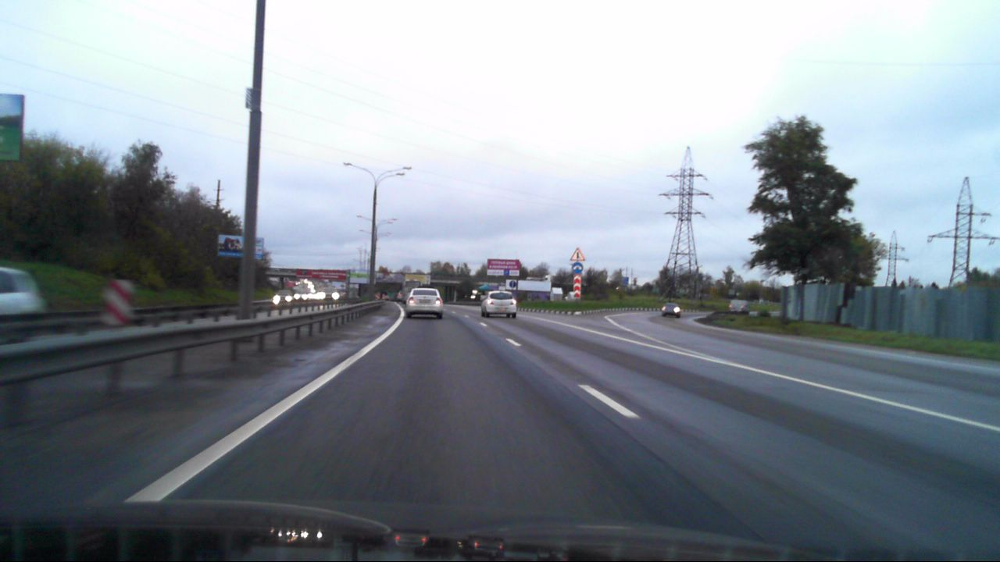

In [ ]:
cv2_imshow(images2[7])

In [ ]:
!mkdir images_with_signs

In [ ]:
cv2.imwrite( "/content/images_with_signs/image0.jpg", images2[3])

True

In [ ]:
create_animation(images2)